In [ ]:
# IMPORT & VISUALIZATION of ALL GASES, FILTERS, AND IR SOURCE
# ===============================================================================
# This cell consolidates all gas imports, filter imports, normalization, and visualization

# Core imports and setup
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objs as go
from matplotlib.pyplot import figure
import math
from math import pi
import mpld3
import os

# Enable inline plotting
%matplotlib inline
mpld3.enable_notebook()

# ===============================================================================
# UTILITY FUNCTIONS
# ===============================================================================

def wave(WN):
    """Convert Wavenumber (1/cm) to Wavelength (micrometers)"""
    N = WN.size
    WL = np.zeros(N)
    for i in range(N):
        WL[i] = (1/WN[i])  # Convert to wavelength [cm]
    WLm = WL/100      # [m] 
    WLmic = WLm/(1e-6)  # [micron]
    return WLmic

def gaussian(x, mu, sig):
    """Gaussian function for filters"""
    return np.exp(-np.power(x - mu, 2.) / (2 * np.power(sig, 2.)))

def HighPass(x, cutoff, n):
    """High-pass filter"""
    Wc = cutoff 
    lp = 1 / np.sqrt(1 + (x / Wc)**(2 * n))
    lp = lp / np.max(np.abs(lp))
    hp = 1 - lp
    return hp

def LowPass(x, cutoff, n):
    """Low-pass filter"""
    Wc = cutoff
    lp = 1 / np.sqrt(1 + (x / Wc)**(2 * n))
    lp = lp / np.max(np.abs(lp))
    return lp

def BandPass(x, center_freq, bandwidth, n):
    """Band-pass filter"""
    W0 = center_freq
    BW = bandwidth/1000
    s = x / W0
    bp = 1 / np.sqrt(1 + ((s**2 - 1) / (s * BW / W0))**(2 * n))
    bp = bp / np.max(np.abs(bp))
    return bp

# ===============================================================================
# GAS DATA LOADING AND PROCESSING
# ===============================================================================

# Define gas information
gas_info = {
    'CH4': {'file': 'CH4_25T.xlsx', 'name': 'Methane (CH4)', 'color': 'blue'},
    'C4H8': {'file': 'BUTENE1_25T.xlsx', 'name': 'Butene (C4H8)', 'color': 'green'},
    'C3H8': {'file': 'C3H8_25T.xlsx', 'name': 'Propane (C3H8)', 'color': 'red'},
    'C2H6': {'file': 'Ethene_25T.xlsx', 'name': 'Ethane (C2H6)', 'color': 'orange'},
    'n_Butane': {'file': 'Butane_25T.xlsx', 'name': 'n-Butane', 'color': 'purple'},
    'H2O': {'file': 'H2O_25T.xlsx', 'name': 'Water (H2O)', 'color': 'cyan'},
    'CO2': {'file': 'CO2_25T.xlsx', 'name': 'Carbon Dioxide (CO2)', 'color': 'brown'}
}

# Base path for spectra files
base_path = "G:/My Drive/CODE FOR IR/spectrums/"

# Storage for gas data
gas_data = {}
gas_wavelengths = {}
gas_absorptions = {}
wavelength_ranges = {}

print("Loading gas spectral data...")

# Load all gas data
for gas_key, gas_props in gas_info.items():
    try:
        # Load Excel file
        data = pd.read_excel(base_path + gas_props['file'])
        data_array = data.to_numpy()
        
        # Convert wavenumber to wavelength
        wavelength = wave(data_array[:, 0])
        absorption = np.abs(data_array[:, 1])
        
        # Store data
        gas_data[gas_key] = data_array
        gas_wavelengths[gas_key] = wavelength
        gas_absorptions[gas_key] = absorption
        
        # Track wavelength range
        wavelength_ranges[gas_key] = {'min': np.min(wavelength), 'max': np.max(wavelength)}
        
        print(f"✓ Loaded {gas_props['name']}: {len(wavelength)} points, range: {wavelength_ranges[gas_key]['min']:.2f}-{wavelength_ranges[gas_key]['max']:.2f} μm")
        
    except Exception as e:
        print(f"✗ Failed to load {gas_props['name']}: {e}")

# ===============================================================================
# FIND COMMON WAVELENGTH RANGE
# ===============================================================================

# Calculate common wavelength range (intersection of all gases)
min_wavelengths = [ranges['min'] for ranges in wavelength_ranges.values()]
max_wavelengths = [ranges['max'] for ranges in wavelength_ranges.values()]

common_min = np.max(min_wavelengths)  # Max of minimums
common_max = np.min(max_wavelengths)  # Min of maximums

print(f"\nCommon wavelength range: {common_min:.2f} - {common_max:.2f} μm")

# Create unified wavelength grid
n_points = 5000  # High resolution
UWV = np.linspace(common_min, common_max, n_points)

# ===============================================================================
# INTERPOLATE ALL GASES TO COMMON GRID
# ===============================================================================

gas_spectra_normalized = {}
Labels = []

# LEL concentrations for each gas [CH4, C4H8, C3H8, C2H6, n_Butane, H2O, CO2]
LEL_vec = [0.044, 0.016, 0.0237, 0.044, 0.029, 0.044, 0.01]

print("\nInterpolating gases to common wavelength grid...")

gas_counter = 0
for gas_key, gas_props in gas_info.items():
    if gas_key in gas_wavelengths:
        # Find indices within common range
        wl = gas_wavelengths[gas_key]
        abs_data = gas_absorptions[gas_key]
        
        # Filter data to common range
        mask = (wl >= common_min) & (wl <= common_max)
        wl_filtered = wl[mask]
        abs_filtered = abs_data[mask]
        
        if len(wl_filtered) > 10:  # Ensure sufficient data points
            # Interpolate to unified grid
            interpolated = np.interp(UWV, wl_filtered, abs_filtered)
            
            # Store interpolated spectrum for global access
            globals()[f"spec_interp{gas_counter+2}"] = interpolated
            
            # Convert to Transmission using LEL concentrations
            if gas_counter == 6:  # Water (index 6 in LEL_vec)
                transmission = np.exp(-LEL_vec[gas_counter] * interpolated)
            else:
                transmission = np.power(10, -1e6 * LEL_vec[gas_counter] * interpolated)
            
            # Store transmission spectrum
            globals()[f"newspec{gas_counter+2}n"] = transmission
            
            # Normalize transmission (0-1 range)
            transmission_norm = (transmission - np.min(transmission)) / (np.max(transmission) - np.min(transmission))
            
            gas_spectra_normalized[gas_key] = transmission_norm
            Labels.append(gas_props['name'])
            
            print(f"✓ Interpolated {gas_props['name']} with LEL = {LEL_vec[gas_counter]}")
            gas_counter += 1
        else:
            print(f"✗ Insufficient data for {gas_props['name']} in common range")

# ===============================================================================
# FILTER CHARACTERISTICS
# ===============================================================================

print("\nSetting up filter characteristics...")

# Filter parameters (based on your original code)
# Filter A (NOC)
mu_A, sig_A = 1.7, 0.025
# Filter B (THOR Water)  
mu_B, sig_B = 1.9, 0.025
# Filter C (NOC3)
mu_C, sig_C = 2.1, 0.025
# Filter D (NOC)
mu_D, sig_D = 2.3, 0.025

# Generate filters on common wavelength grid
filter_A = gaussian(UWV, mu_A, sig_A)
filter_B = gaussian(UWV, mu_B, sig_B)  
filter_C = gaussian(UWV, mu_C, sig_C)
filter_D = gaussian(UWV, mu_D, sig_D)

# Normalize filters
filter_A = filter_A / np.max(filter_A)
filter_B = filter_B / np.max(filter_B)
filter_C = filter_C / np.max(filter_C)
filter_D = filter_D / np.max(filter_D)

print("✓ Generated filters A, B, C, D")

# ===============================================================================
# BLACK BODY RADIATION (IR Source)
# ===============================================================================

print("Calculating black body radiation...")

# Constants
h = 6.626e-34  # Planck constant [J⋅s]
c = 3e8        # Speed of light [m/s]
k = 1.381e-23  # Boltzmann constant [J/K]
Temp = 1273    # Temperature [K] (1000°C)

# Convert wavelength to meters for calculation
WL_m = UWV * 1e-6

# Black body radiation calculation
BBR = np.zeros(len(UWV))
for i in range(len(UWV)):
    const = (2 * h * (c**2)) / (WL_m[i]**5)
    expo = h * c / (k * Temp * WL_m[i])
    BBR[i] = const * 1 / (math.exp(expo) - 1)

# Normalize black body radiation
BBR_norm = BBR / np.max(BBR)

print("✓ Calculated black body radiation")

# ===============================================================================
# COMPREHENSIVE VISUALIZATION
# ===============================================================================

print("Creating comprehensive visualization...")

# Create interactive plot with Plotly
fig = go.Figure()

# Add gas spectra
for gas_key, transmission in gas_spectra_normalized.items():
    if gas_key in gas_info:
        fig.add_trace(go.Scatter(
            x=UWV, 
            y=transmission,
            mode='lines',
            name=gas_info[gas_key]['name'],
            line=dict(color=gas_info[gas_key]['color'], width=2)
        ))

# Add filters
fig.add_trace(go.Scatter(x=UWV, y=filter_A, mode='lines', name='Filter A (1.7μm)', 
                        line=dict(color='black', dash='dash', width=3)))
fig.add_trace(go.Scatter(x=UWV, y=filter_B, mode='lines', name='Filter B (1.9μm)', 
                        line=dict(color='gray', dash='dash', width=3)))
fig.add_trace(go.Scatter(x=UWV, y=filter_C, mode='lines', name='Filter C (2.1μm)', 
                        line=dict(color='darkblue', dash='dash', width=3)))
fig.add_trace(go.Scatter(x=UWV, y=filter_D, mode='lines', name='Filter D (2.3μm)', 
                        line=dict(color='darkred', dash='dash', width=3)))

# Add black body radiation
fig.add_trace(go.Scatter(x=UWV, y=BBR_norm, mode='lines', name='IR Source (Black Body)', 
                        line=dict(color='gold', width=2)))

# Update layout
fig.update_layout(
    title='Consolidated IR Gas Detection Simulator - Transmission Spectra & Filters',
    xaxis_title='Wavelength (μm)',
    yaxis_title='Normalized Transmission',
    width=1200,
    height=700,
    hovermode='x unified',
    legend=dict(x=0.02, y=0.98)
)

fig.show()

# ===============================================================================
# SUMMARY STATISTICS
# ===============================================================================

print(f"\n{'='*60}")
print("CONSOLIDATION SUMMARY")
print(f"{'='*60}")
print(f"✓ Successfully loaded {len(gas_spectra_normalized)} gases")
print(f"✓ Common wavelength range: {common_min:.2f} - {common_max:.2f} μm")
print(f"✓ Unified grid resolution: {n_points} points")
print(f"✓ Generated 4 detection filters")
print(f"✓ Calculated IR source characteristics")
print(f"✓ All data normalized to [0-1] transmission scale")

# Store key variables for next cells
NOS = len(gas_spectra_normalized)  # Number of species
print(f"✓ Ready for concentration analysis with {NOS} gas species")

# Store other needed variables
newspec1n = BBR_norm
detector_interp = np.ones_like(UWV)  # Ideal detector response

# LEL vector for reference in later cells
LEL_vec_global = LEL_vec

print("✓ Variables prepared for next analysis cells")
print(f"✓ LEL concentrations applied: {LEL_vec}")

Loading gas spectral data...
✓ Loaded Methane (CH4): 97901 points, range: 1.54-16.67 μm
✓ Loaded Butene (C4H8): 99145 points, range: 1.54-19.05 μm
✓ Loaded Propane (C3H8): 97901 points, range: 1.54-16.67 μm
✓ Loaded Ethane (C2H6): 97901 points, range: 1.54-16.67 μm
✓ Loaded n-Butane: 97901 points, range: 1.54-16.67 μm
✓ Loaded Water (H2O): 115325 points, range: 1.33-18.18 μm
✗ Failed to load Carbon Dioxide (CO2): [Errno 2] No such file or directory: 'G:/My Drive/CODE FOR IR/spectrums/CO2_25T.xlsx'

Common wavelength range: 1.54 - 16.67 μm

Interpolating gases to common wavelength grid...
✓ Interpolated Methane (CH4) with LEL = 0.044
✓ Interpolated Butene (C4H8) with LEL = 0.016
✓ Interpolated Propane (C3H8) with LEL = 0.0237
✓ Interpolated Ethane (C2H6) with LEL = 0.044
✓ Interpolated n-Butane with LEL = 0.029
✓ Interpolated Water (H2O) with LEL = 0.044

Setting up filter characteristics...
✓ Generated filters A, B, C, D
Calculating black body radiation...
✓ Calculated black body radia


CONSOLIDATION SUMMARY
✓ Successfully loaded 6 gases
✓ Common wavelength range: 1.54 - 16.67 μm
✓ Unified grid resolution: 5000 points
✓ Generated 4 detection filters
✓ Calculated IR source characteristics
✓ All data normalized to [0-1] transmission scale
✓ Ready for concentration analysis with 6 gas species
✓ Variables prepared for next analysis cells
✓ LEL concentrations applied: [0.044, 0.016, 0.0237, 0.044, 0.029, 0.044, 0.01]


In [ ]:
# noise generation for data augmentation
noise = []
noise_class=[]

# # Generate 2500 random vectors
# for _ in range(2000):
#     vec = np.random.rand(6)
#     #vec = (vec - vec.min()) / (vec.max() - vec.min())
#     noise.append(vec)
#     noise_class.append(NOS)

for _ in range(100):
    vec = (np.ones(6))
    noise.append(vec)
    noise_class.append(NOS)

for _ in range(2400):
    vec = 0.95 + 0.05 * np.random.rand(6)
    noise.append(vec)
    noise_class.append(NOS)

# df = pd.read_excel('DATA_RATIO_20250811_160953.xlsx')
# nim=np.array(df)
# gas_class=[]
# gas_train=[]
# for i in range (len(df)):
#     record_data=nim[i,1:]
#     record_data=np.array(record_data, dtype=np.float32)
#     gas_train.append(record_data)
#     gas_class.append(4)

# gas_train=gas_train+noise
# gas_class=gas_class+noise_class

In [ ]:
#Data Type Conversion
gas_class=np.array(gas_class)
gas_train=np.array(gas_train)
gas_train.shape
len(gas_train)

17514

In [ ]:
# Ratio 2- gas detection
figure(num=None, figsize=(10, 8), dpi=80, facecolor='w', edgecolor='k')

plt.xlabel("Concentration") 
plt.ylabel("Ratio") 

for i in range(NOS-2):
    plt.plot(100*CL_vec,Ratio2_Mat[:,i],label=Labels[i],color=colors[i])
    #print(i,Labels[i])
plt.legend(loc="lower right")
plt.show()

In [ ]:
# Ratio 4 - water vapor
figure(num=None, figsize=(10, 8), dpi=80, facecolor='w', edgecolor='k')

plt.xlabel("Concentration") 
plt.ylabel("Ratio") 

for i in range(NOS-2):
    plt.plot(100*CL_vec,Ratio4_Mat[:,i],label=Labels[i]+' 2.3',color=colors[i])


plt.legend(loc="lower right")
plt.show()

In [ ]:
# Ratio3
figure(num=None, figsize=(10, 8), dpi=80, facecolor='w', edgecolor='k')

plt.xlabel("Concentration") 
plt.ylabel("Ratio") 

for i in range(NOS-2):
    plt.plot(100*CL_vec,Ratio3_Mat[:,i],label=Labels[i]+'3.4',color=colors[i])


plt.legend(loc="lower right")
plt.show()

# AI Gas detection

In [ ]:
fig = go.Figure()
for i in range(NOS):
    fig.add_trace(go.Scatter(x=UWV,y=globals()["newspec"+str(i+2)+'n'], mode='lines', name=Labels[i]))
# fig.add_trace(go.Scatter(x=UWV,y=filter_A-filter_C, mode='lines', name='A-C'))
# fig.add_trace(go.Scatter(x=UWV,y=filter_A-filter_D, mode='lines', name='A-D'))
# fig.add_trace(go.Scatter(x=UWV,y=filter_B, mode='lines', name='B'))
fig.add_trace(go.Scatter(x=UWV,y=filter_A, mode='lines', name='A-ch2',line=dict(color='black')))
fig.add_trace(go.Scatter(x=UWV,y=filter_B, mode='lines', name='B-ch4',line=dict(color='black')))
fig.add_trace(go.Scatter(x=UWV,y=filter_C, mode='lines', name='C-ch3',line=dict(color='olivedrab')))
fig.add_trace(go.Scatter(x=UWV,y=filter_D, mode='lines', name='D-ch1',line=dict(color='darkmagenta')))
fig.add_trace(go.Scatter(x=UWV,y=detector_interp, mode='lines', name='INGAS',line=dict(color='black')))
fig.update_layout(title='Transmission Spectrum')
fig.show()

In [ ]:
#[0="Methane",1-"Butene",2-"Propane",4-'Ethane',3-'n-Butane',5-"Water fog", 6-"Water dtops"]

In [ ]:
Y_train=gas_class
X_train=gas_train

In [ ]:
# Shuffle
rng = np.random.default_rng()
state = rng.bit_generator.state
rng.shuffle(X_train)
rng.bit_generator.state = state 
rng.shuffle(Y_train)

In [ ]:
Number=500
X_test, X_train = X_train[:Number] , X_train[Number:]
Y_test, Y_train = Y_train[:Number] , Y_train[Number:]

Load Libraries

In [ ]:

import keras
from keras.models import Model
from keras.models import Sequential
from keras.layers import Dense, Flatten, Dropout,Input, Concatenate, Lambda
#from keras.layers.convolutional import Conv2D, MaxPooling2D
#from keras.utils import to_categorical
from tensorflow.keras.utils import to_categorical
from keras.callbacks import ReduceLROnPlateau
from keras.callbacks import EarlyStopping
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import ModelCheckpoint

Model

In [ ]:
Labels_AI=["Methane","Butene","Propane",'Ethane',"Fog", "Drops",'None']
Input_Size=6
Output_Size=len(Labels_AI)

In [ ]:
#  Model 

def Gas_Detection():   # U
    #Create Model
    
    model = keras.models.Sequential([keras.Input(shape=(Input_Size,)),
                                 keras.layers.Dense(10, activation="tanh",name="dense_1"),
                                 keras.layers.Dense(18, activation="tanh",name="dense_2"), #small-remove
                                 keras.layers.Dropout(0.1,name="dense_4"), #small-remove
                                 keras.layers.Dense(12, activation="tanh",name="dense_3"), #small-remove
                                 keras.layers.Dense(Output_Size, activation="softmax",name="dense_out")
    ])

    adam=keras.optimizers.Adam(learning_rate=0.01,beta_1=0.5,beta_2=0.5,epsilon=1e-07,amsgrad=False,name="Adam",)
    
    categorical_crossentropy=keras.losses.CategoricalCrossentropy(from_logits=False,label_smoothing=0.0,axis=-1,reduction="sum_over_batch_size",name="categorical_crossentropy",dtype=None,)
    
    #sparse_categorical_crossentropy
    model.compile(loss="sparse_categorical_crossentropy", optimizer=adam,metrics=["accuracy"])
    return model

In [ ]:
# import tensorflow as tf
# def predict_with_threshold(model, x, T=2.0, threshold=0.7):
#     # Get logits
#     logits = model.predict(x, verbose=0)

#     # Apply temperature scaling
#     exp_scaled = tf.exp(logits / T)
#     probs = exp_scaled / tf.reduce_sum(exp_scaled, axis=-1, keepdims=True)

#     # Convert to numpy
#     probs = probs.numpy()
#     max_probs = np.max(probs, axis=1)
#     pred_classes = np.argmax(probs, axis=1)

#     # Apply threshold
#     results = []
#     for p, cls in zip(max_probs, pred_classes):
#         if p < threshold:
#             results.append(("unknown", p))
#         else:
#             results.append((cls, p))
#     return results


In [ ]:
# #  Model 

# def Gas_Detection2():   # U
#     #Create Model
    
#     model = keras.models.Sequential([keras.Input(shape=(Input_Size,)),
#                                  keras.layers.Dense(10, activation="tanh",name="dense_1"),
#                                  keras.layers.Dense(18, activation="tanh",name="dense_2"),
#                                  keras.layers.Dense(12, activation="tanh",name="dense_3"),
#                                  keras.layers.Dense(Output_Size, activation=None,name="dense_out")
#     ])

#     adam=keras.optimizers.Adam(learning_rate=0.01,beta_1=0.5,beta_2=0.5,epsilon=1e-07,amsgrad=False,name="Adam",)
    
#     categorical_crossentropy=keras.losses.CategoricalCrossentropy(from_logits=False,label_smoothing=0.0,axis=-1,reduction="sum_over_batch_size",name="categorical_crossentropy",dtype=None,)
    
#     #sparse_categorical_crossentropy
#     model.compile(loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),optimizer=adam,metrics=["accuracy"])
#     return model

In [ ]:
model=Gas_Detection()
model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_1 (Dense)                      │ (None, 10)                  │              70 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 18)                  │             198 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dropout)                    │ (None, 18)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 12)                  │             228 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_out (Dense)                    │ (None, 7)                   │              91 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 587 (2.29 KB)

 Trainable params: 587 (2.29 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
reduce_lr_acc = ReduceLROnPlateau(monitor='val_accuracy', factor=0.1, patience=7, verbose=1, min_delta=1e-4, mode='max')
earlyStopping = EarlyStopping(monitor='val_accuracy', patience=10, verbose=0, mode='max')
mcp_save = ModelCheckpoint('best_gas.weights.h5', save_weights_only=True, save_best_only=True, monitor='val_accuracy', mode='min')
callbacks=[reduce_lr_acc,mcp_save]

In [ ]:
history=model.fit(X_train, Y_train,batch_size=250, epochs=30,validation_split=0.2,shuffle='True',callbacks=callbacks)

Epoch 1/30
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 26ms/step - accuracy: 0.5095 - loss: 1.2908 - val_accuracy: 0.9603 - val_loss: 0.2525 - learning_rate: 0.0100
Epoch 2/30
55/55 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.9568 - loss: 0.1869 - val_accuracy: 0.9824 - val_loss: 0.0702 - learning_rate: 0.0100
Epoch 3/30
55/55 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.9726 - loss: 0.0747 - val_accuracy: 0.9677 - val_loss: 0.0636 - learning_rate: 0.0100
Epoch 4/30
55/55 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.9845 - loss: 0.0401 - val_accuracy: 0.9994 - val_loss: 0.0063 - learning_rate: 0.0100
Epoch 5/30
55/55 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.9939 - loss: 0.0191 - val_accuracy: 0.9997 - val_loss: 0.0033 - learning_rate: 0.0100
Epoch 6/30
55/55 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.9918 - loss: 0.0241 - val_accuracy: 0.9997 - val_loss: 0.0030 - learning_rate: 0.0100
Epoch 7/30
55/55 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9955 - loss: 0.0126 - val_acc

In [ ]:
model.save_weights('model_gas_new_normalize_less_gas_none2.weights.h5')

In [ ]:
# Concentratios vector
CL_vec=np.linspace(0, 1, 500)

THICK_vec=np.linspace(0, 0.3, 250)


# Precompute "no gas" signal values
def compute_signal(filter_band):
    return np.dot(filter_band * newspec1n, detector_interp)

signal_A_NG = compute_signal(filter_A)
signal_B_NG = compute_signal(filter_B)
norm_AB_NG = 1#signal_A_NG + signal_B_NG
signal_A_NG /= norm_AB_NG
signal_B_NG /= norm_AB_NG

signal_C_NG = compute_signal(filter_C)
signal_D_NG = compute_signal(filter_D)
norm_CD_NG =  1#signal_C_NG + signal_D_NG
signal_C_NG /= norm_CD_NG
signal_D_NG /= norm_CD_NG

Ratio_NG = np.array([
    signal_D_NG / signal_B_NG,
    signal_D_NG / signal_C_NG,
    signal_D_NG / signal_A_NG,
    signal_A_NG / signal_B_NG,
    signal_A_NG / signal_C_NG,
    signal_C_NG / signal_B_NG,
], dtype=np.float32)


# Preload spec_interp instead of using globals
spec_interp_list_test = [globals()[f"spec_interp{i+2}"] for i in range(NOS)]

Ratio1_NG=signal_D_NG/signal_B_NG
Ratio2_NG=signal_D_NG/signal_C_NG
Ratio3_NG=signal_D_NG/signal_A_NG

Ratio4_NG=signal_A_NG/signal_B_NG
Ratio5_NG=signal_A_NG/signal_C_NG
Ratio6_NG=signal_C_NG/signal_B_NG

## With gas
# First Gas

n=1 #Concentartion
i=0 #Gas [0= "Methane",1= "Butene",2="Propane",3='Ethane',4="Fog", 5= "Drops 2"]

# Second Gas
n2=440#Concentartion
i2=4


CL=CL_vec[n] #ppm meter
thickness=THICK_vec[n]

 


spec_interp_test = spec_interp_list_test[i]
spec_interp2_test = spec_interp_list_test[i2]

if i < NOS - 1:
    T = np.power(10, -1e6 * CL * spec_interp_test)
    T2=np.power(10, -1e6 * CL * spec_interp2_test)
    T=T*T2
else:  # water
    T = np.exp(-thickness * spec_interp_test)

Transmit_signal = newspec1n * T * detector_interp

sA = np.dot(filter_A, Transmit_signal)
sB = np.dot(filter_B, Transmit_signal)
sC = np.dot(filter_C, Transmit_signal)
sD = np.dot(filter_D, Transmit_signal)

# # Opening 1: D,C. Opening 2: A,B    
# dirty window 2
AB_factor=1
sA=AB_factor*sA
sB=AB_factor*sB

# # # dirty window 1
CD_factor=1
sC=CD_factor*sC
sD=CD_factor*sD


sAR=sA/signal_A_NG
sBR=sB/signal_B_NG
sCR=sC/signal_C_NG
sDR=sD/signal_D_NG
        
        
norm_AB = max(sAR,sBR)#sA + sB
norm_CD = max(sCR,sDR)#sC + sD

sAN = sA / norm_AB
sBN = sB / norm_AB
sCN = sC / norm_CD
sDN = sD / norm_CD



ratios = np.array([
    sDN / sBN,
    sDN / sCN,
    sDN / sAN,
    sAN / sBN,
    sAN / sCN,
    sCN / sBN
], dtype=np.float32)


norm_ratios = ratios / Ratio_NG
data = (norm_ratios - norm_ratios.min()) / (norm_ratios.max() - norm_ratios.min())
print("First Gas:")
print ("Gas:",Labels_AI[i])
print ("Concentration:",np.round(100*CL_vec[n],2), '% LEL')

print("Second Gas")
print ("Gas:",Labels_AI[i2])
print ("Concentration:",np.round(100*CL_vec[n2],2), '% LEL')


First Gas:
Gas: Methane
Concentration: 0.2 % LEL
Second Gas
Gas: Fog
Concentration: 88.18 % LEL


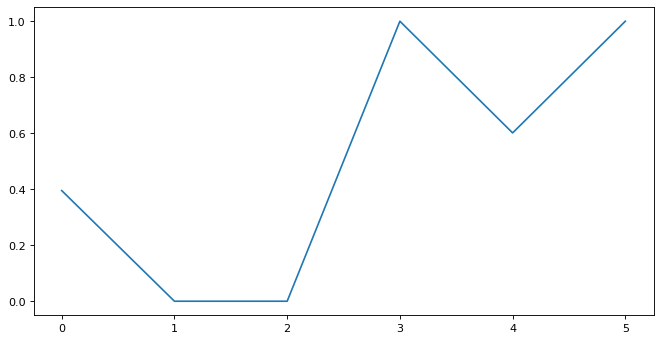

In [ ]:
figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')
plt.plot(data)
plt.show()

In [ ]:
data = np.array(data, dtype=np.float32)
input1=np.expand_dims(data, axis=0)
AI_output_raw=(model.predict(input1, verbose=0))
AI_output=(AI_output_raw)[0]
AI_outputp=int(np.argmax(AI_output))
print('Predicted Gas:',Labels_AI[AI_outputp])
for j in range(6):
    print(Labels_AI[j],':',np.round(100*AI_output_raw[0][j],2))

Predicted Gas: Methane
Methane : 98.98
Butene : 0.0
Propane : 0.0
Ethane : 0.0
Fog : 1.02
Drops : 0.0


In [ ]:
pred = model.predict(input1)  # shape: (1, 7)
max_prob = np.max(pred)
pred_class = np.argmax(pred)
max_prob

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


np.float32(0.9999949)

AI Prediction

In [ ]:
model.load_weights('model_gas_new_normalize_less_gas_none.weights.h5')

Test

In [ ]:
# #df = pd.read_excel('DATA_RATIO_20250812_145522.xlsx')
# df = pd.read_excel('DATA_RATIO_20250812_150153.xlsx')
# #df = pd.read_excel('DATA_RATIO_20250811_160953.xlsx')
# nim=np.array(df)

# for i in range (len(df)):
#     data=nim[i,1:]
#     data = np.array(data, dtype=np.float32) 
#     input1=np.expand_dims(data, axis=0)
#     AI_output_raw=(model.predict(input1, verbose=0))
#     AI_output=(AI_output_raw)[0]
#     AI_outputp=int(np.argmax(AI_output))
#     print('Predicted Gas:',Labels_AI[AI_outputp])
#     print(np.round(100*AI_output_raw[0][AI_outputp]))

In [ ]:
# input1=np.expand_dims(data, axis=0)
# predictions = predict_with_threshold(model, input1, T=2.0, threshold=0.7)
# for cls, prob in predictions:
#     print(f"Prediction: {cls}, Confidence: {prob:.2f}")

In [ ]:
data

array([0.00000000e+00, 8.84278396e-16, 3.01223552e-01, 6.34674817e-01,
       6.34674817e-01, 1.00000000e+00])

In [ ]:

# df = pd.read_excel('TEST2.xlsx')
# nim=np.array(df)
# data=nim[10,:]
# data

In [ ]:
# input1=np.expand_dims(data, axis=0)
# AI_output_raw=(model.predict(input1, verbose=0))
# AI_output=(AI_output_raw)[0]
# AI_outputp=int(np.argmax(AI_output))
# print('Predicted Gas:',Labels_AI[AI_outputp])

# Train data view

In [ ]:
%matplotlib widget


In [ ]:
train_class=gas_class#np.load('gas_calss_normalize_relative_less_gas.npy')
train_data=gas_train#np.load('gas_Train_normalize_relative_less_gas.npy')

In [ ]:
# for i in range (train_data.shape[0]):
#     train_data[i,:]=(train_data[i,:]-np.min(train_data[i,:]))/(np.max(train_data[i,:])-np.min(train_data[i,:]))
    #train_data[i,:]=(train_data[i,:])/(np.max(train_data[i,:]))


In [ ]:
# mean = train_data.mean(axis=0)        # Mean of each feature (column)
# std = train_data.std(axis=0)          # Standard deviation of each feature
# train_data = (train_data - mean) 

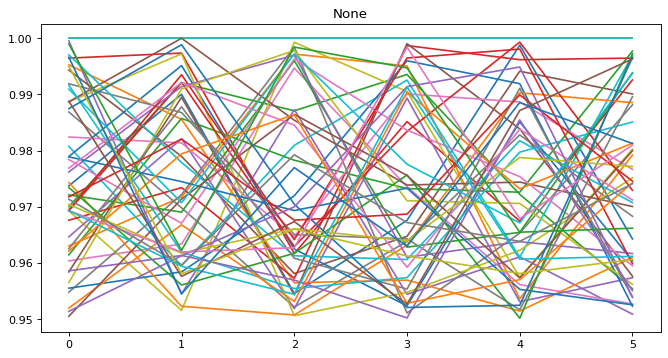

15224

In [ ]:
figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')
#plt.plot(one)
j=0
for i in range(len(train_class)):
    if train_class[i]==6:
        plt.plot(train_data[i])
        j=j+1
        if j>150:
            break
plt.title(Labels_AI[6])
plt.show()
i

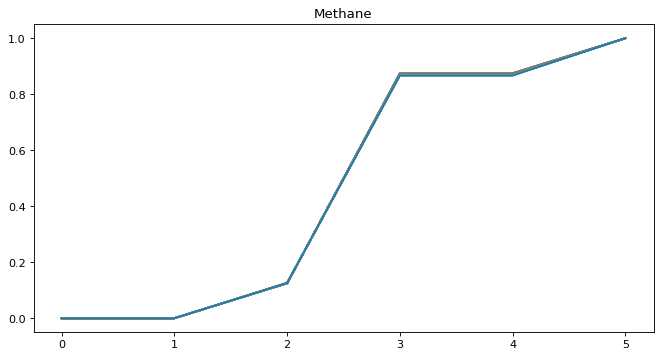

300

In [ ]:
figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')
#plt.plot(one)
j=0
for i in range(len(train_class)):
    if train_class[i]==0:
        plt.plot(train_data[i])
        j=j+1
        if j>50:
            break
plt.title(Labels_AI[0])
plt.show()
i

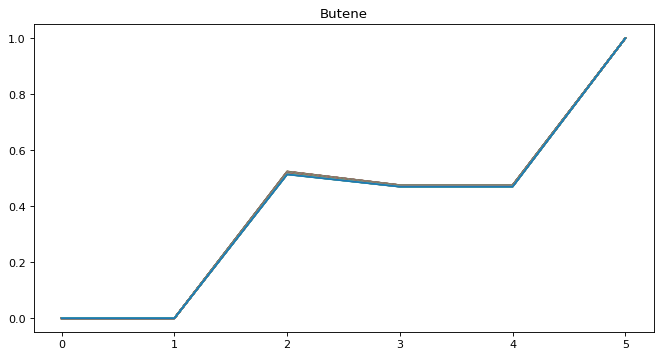

301

In [ ]:
figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')
#plt.plot(one)
j=0
for i in range(len(train_class)):
    if train_class[i]==1:
        plt.plot(train_data[i])
        j=j+1
        if j>50:
            break
plt.title(Labels_AI[1])
plt.show()
i

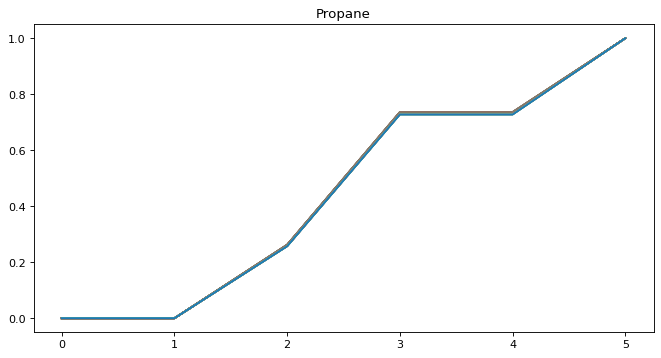

302

In [ ]:
figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')

j=0
#plt.plot(one)
for i in range(len(train_class)):
    if train_class[i]==2:
        plt.plot(train_data[i])
        j=j+1
        if j>50:
            break
plt.title(Labels_AI[2])
plt.show()
i

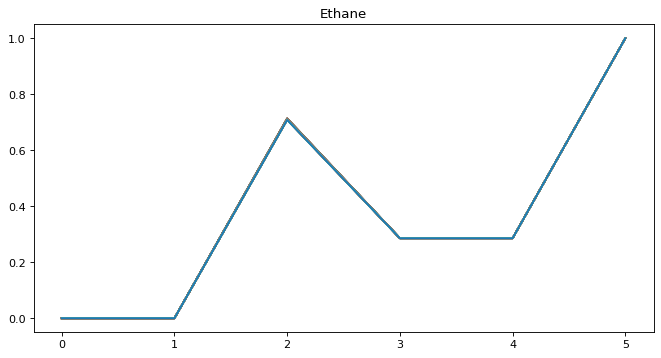

303

In [ ]:
figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')
#plt.plot(one)
j=0
for i in range(len(train_class)):
    if train_class[i]==3:
        plt.plot(train_data[i])
        j=j+1
        if j>50:
            break
plt.title(Labels_AI[3])
plt.show()
i

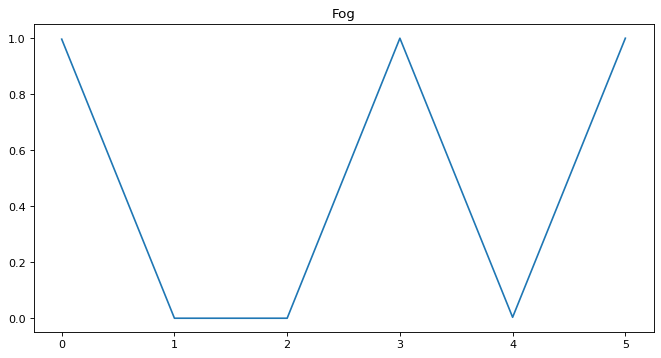

4

In [ ]:
figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')
#plt.plot(one)
j=0
for i in range(len(train_class)):
    if train_class[i]==4:
        plt.plot(train_data[i])
        j=j+1
        if j>0:
            break
plt.title(Labels_AI[4])
plt.show()
i

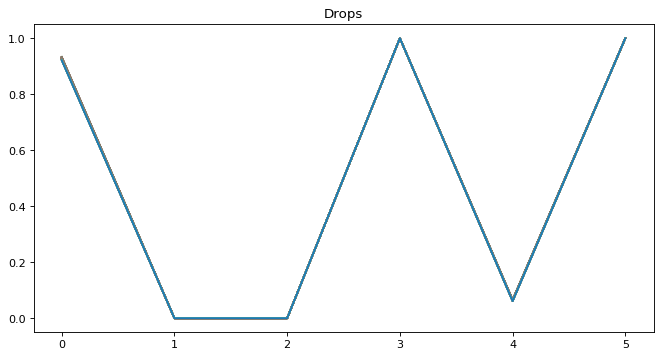

In [ ]:
figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')
#plt.plot(one)
j=0
for i in range(len(train_class)):
    if train_class[i]==5:
        plt.plot(train_data[i])
        j=j+1
        if j>50:
            break

plt.title(Labels_AI[5])
plt.show()


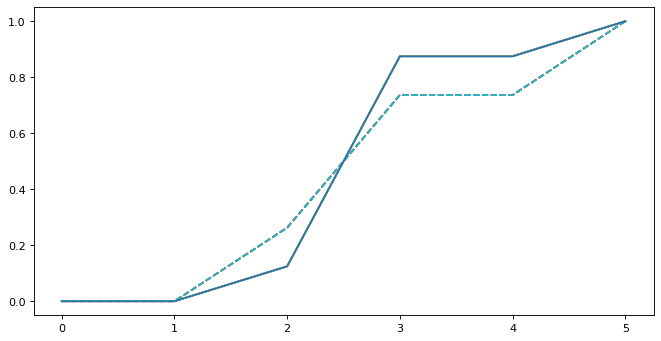

In [ ]:
figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')
#plt.plot(one)
j=0
line=['solid','solid','--']
for i in range(len(train_class)):
    if train_class[i]==0 or train_class[i]==2:
        plt.plot(train_data[i],label=Labels_AI[train_class[i]],linestyle=line[train_class[i]])
        j=j+1
        if j>10:
            break
#plt.title(Labels_AI[0])
#plt.legend()
plt.show()

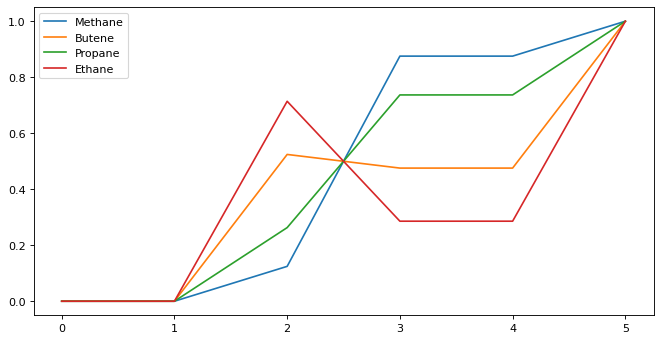

In [ ]:
figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')


    
plt.plot((train_data[0]),label=Labels_AI[train_class[0]])
plt.plot((train_data[1]),label=Labels_AI[train_class[1]])
plt.plot((train_data[2]),label=Labels_AI[train_class[2]])
plt.plot((train_data[3]),label=Labels_AI[train_class[3]])
#plt.plot((train_data[4]),label=Labels_AI[train_class[4]])
#plt.plot(train_data[5]**2,label=Labels_AI[train_class[5]])
plt.legend()

plt.show()

In [ ]:
# data2=[0.245110043,	0,	0.318681156,	0.56520927,	0.276423647,	1]
# data=[0.239852513,0,0.296198668,0.537693142,0.238242025,1]
# figure(num=None, figsize=(10, 5), dpi=80, facecolor='w', edgecolor='k')


    
# plt.plot((train_data[0]),label=Labels_AI[train_class[0]])
# plt.plot((train_data[2]),label=Labels_AI[train_class[2]])
# plt.plot((data),label='data')
# plt.plot((data2),label='data2')

# plt.legend()

# plt.show()

# PCA

In [ ]:
from sklearn.decomposition import PCA


In [ ]:
A=train_data[0]
B=train_data[1]
C=train_data[2]
D=train_data[3]
E=train_data[4]
F=train_data[5]

In [ ]:
X = np.vstack([A, B, C, D,E,F])
X_pca = PCA(n_components=2).fit_transform(X)



In [ ]:
import matplotlib.pyplot as plt

X = np.vstack([A, B, C, D, E, F])
labels = ['A', 'B', 'C', 'D','E','F']

from sklearn.decomposition import PCA
X_pca = PCA(n_components=2).fit_transform(X)

plt.figure(figsize=(6, 6))
for i, label in enumerate(labels):
    plt.scatter(X_pca[i, 0], X_pca[i, 1], label=label)
    plt.text(X_pca[i, 0], X_pca[i, 1], label, fontsize=12, ha='right')
plt.title("PCA projection of input vectors")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# data2=[0.245110043,	0,	0.318681156,	0.56520927,	0.276423647,	1]
# data=[0.239852513,0,0.296198668,0.537693142,0.238242025,1]

In [ ]:
import matplotlib.pyplot as plt

X = np.vstack([A, B, C, D])
labels = ['A', 'B', 'C', 'D']

from sklearn.decomposition import PCA
X_pca = PCA(n_components=2).fit_transform(X)

plt.figure(figsize=(6, 6))
plt.scatter(data_pca[0][0], data_pca[0][1], label='test')
for i, label in enumerate(labels):
    plt.scatter(X_pca[i, 0], X_pca[i, 1], label=label)
    
    plt.text(X_pca[i, 0], X_pca[i, 1], label, fontsize=12, ha='right')
plt.title("PCA projection of input vectors")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
data2=[0.245110043,	0,	0.318681156,	0.56520927,	0.276423647,	1]
data=[0.239852513,0,0.296198668,0.537693142,0.238242025,1]

In [ ]:
Y_train=gas_class
X_train=gas_train

In [ ]:
pca = PCA(n_components=2)
X_train2 = pca.fit_transform(X_train)  # shape: (n_samples, 2)

In [ ]:
data_pca = pca.transform(data.reshape(1, -1)) 

In [ ]:
def Gas_Detection_pca():   # U
    #Create Model
    
    model = keras.models.Sequential([keras.Input(shape=(2,)),
                                 keras.layers.Dense(10, activation="tanh",name="dense_1"),
                                 keras.layers.Dense(Output_Size, activation="softmax",name="dense_out")
    ])

    adam=keras.optimizers.Adam(learning_rate=0.01,beta_1=0.5,beta_2=0.5,epsilon=1e-07,amsgrad=False,name="Adam",)
    
    categorical_crossentropy=keras.losses.CategoricalCrossentropy(from_logits=False,label_smoothing=0.0,axis=-1,reduction="sum_over_batch_size",name="categorical_crossentropy",dtype=None,)
    
    #sparse_categorical_crossentropy
    model.compile(loss="sparse_categorical_crossentropy", optimizer=adam,metrics=["accuracy"])
    return model

In [ ]:
model=Gas_Detection_pca()
model.summary()

In [ ]:
history=model.fit(X_train2, Y_train,batch_size=250, epochs=50,validation_split=0.2,shuffle='True',callbacks=callbacks)

In [ ]:
# Concentratios vector
CL_vec=np.linspace(0, 0.1, 600)

THICK_vec=np.linspace(0, 0.3, 600)


# Precompute "no gas" signal values
def compute_signal(filter_band):
    return np.dot(filter_band * newspec1n, detector_interp)

signal_A_NG = compute_signal(filter_A)
signal_B_NG = compute_signal(filter_B)
norm_AB_NG = signal_A_NG + signal_B_NG
signal_A_NG /= norm_AB_NG
signal_B_NG /= norm_AB_NG

signal_C_NG = compute_signal(filter_C)
signal_D_NG = compute_signal(filter_D)
norm_CD_NG =  signal_C_NG + signal_D_NG
signal_C_NG /= norm_CD_NG
signal_D_NG /= norm_CD_NG

Ratio_NG = np.array([
    signal_D_NG / signal_B_NG,
    signal_D_NG / signal_C_NG,
    signal_D_NG / signal_A_NG,
    signal_A_NG / signal_B_NG,
    signal_A_NG / signal_C_NG,
    signal_C_NG / signal_B_NG,
])

# Preload spec_interp instead of using globals
spec_interp_list = [globals()[f"spec_interp{i+2}"] for i in range(NOS-1)]
spec_interp_list.append(globals()["spec_interp8"])  # for water

Ratio1_NG=signal_D_NG/signal_B_NG
Ratio2_NG=signal_D_NG/signal_C_NG
Ratio3_NG=signal_D_NG/signal_A_NG

Ratio4_NG=signal_A_NG/signal_B_NG
Ratio5_NG=signal_A_NG/signal_C_NG
Ratio6_NG=signal_C_NG/signal_B_NG

## With gas
# First Gas
n=150 #Concentartion
i=2 #Gas [0= "Methane",1= "Butene",2="Propane",3='Ethane',4="Water", 5= "Water 2"]
# Second Gas
n2=0#Concentartion
i2=1


CL=CL_vec[n] #ppm meter
thickness=THICK_vec[n]

 


spec_interp = spec_interp_list[i]

if i < NOS - 1:
    T = np.power(10, -1e6 * CL * spec_interp)
else:  # water
    T = np.exp(-thickness * spec_interp)

Transmit_signal = newspec1n * T * detector_interp

sA = np.dot(filter_A, Transmit_signal)
sB = np.dot(filter_B, Transmit_signal)
sC = np.dot(filter_C, Transmit_signal)
sD = np.dot(filter_D, Transmit_signal)

# Opening 1: D,C. Opening 2: A,B    
# dirty window 2
AB_factor=1
sA=AB_factor*sA
sB=AB_factor*sB

# # dirty window 1
CD_factor=1
sC=CD_factor*sC
sD=CD_factor*sD


norm_AB = sA + sB
norm_CD = sC + sD

sAN = sA / norm_AB
sBN = sB / norm_AB
sCN = sC / norm_CD
sDN = sD / norm_CD



ratios = np.array([
    sDN / sBN,
    sDN / sCN,
    sDN / sAN,
    sAN / sBN,
    sAN / sCN,
    sCN / sBN
])


norm_ratios = ratios / Ratio_NG
data = (norm_ratios - norm_ratios.min()) / (norm_ratios.max() - norm_ratios.min())
data_pca = pca.transform(data.reshape(1,-1))
print("First Gas:")
print ("Gas:",Labels_AI[i])
print ("Concentration:",np.round(100*CL_vec[n],2), '% LEL')

# print("Second Gas")
# print ("Gas:",Labels_AI[i2])
# print ("Concentration:",np.round(100*CL_vec[n2],2), '% LEL')

In [ ]:
input1=data_pca
AI_output_raw=(model.predict(input1, verbose=0))
AI_output=(AI_output_raw)[0]
AI_outputp=int(np.argmax(AI_output))
print('Predicted Gas:',Labels_AI[AI_outputp])
for j in range(7):
    print(Labels_AI[j],':',np.round(100*AI_output_raw[0][j],2))

In [ ]:
data2=[0.245110043,	0,	0.318681156,	0.56520927,	0.276423647,	1]
data=[0.239852513,0,0.296198668,0.537693142,0.238242025,1]

In [ ]:
data=np.array(data2)
data_pca = pca.transform(data.reshape(1, -1)) 

In [ ]:
input1=data_pca
AI_output_raw=(model.predict(input1, verbose=0))
AI_output=(AI_output_raw)[0]
AI_outputp=int(np.argmax(AI_output))
print('Predicted Gas:',Labels_AI[AI_outputp])
for j in range(7):
    print(Labels_AI[j],':',np.round(100*AI_output_raw[0][j],2))